# F21AA CW2 AMAZON DATASET

In the CW2 specification, we are supposed to extract the text reviews and the corresponding ratings from 
a dataset. The ratings score different food products to 1 (low rating) up till 5 (maximum rating).  We are requested to use our ‘analytics’ skills to provide insights on the data provided and to propose a categorization system that can automatically rate 
similar text reviews.

Our project is divided into 6 parts:
1. Data Exploration and Visualization
2. Text Processing and Normalization
3. Vector space Model and feature representation
4. Model training, selection and hyperparameter tuning and evaluation
5. Modelling text as a Sequence
6. Topic Modelling of high and low ratings

# IMPORT THE DATA

Here we are importing the required libraries which will be used for data collection and manipulation, for text processing and few machine learning classifiers libraries.

In [1]:
! pip install plotly

In [2]:
! pip install textblob

In [2]:
import pandas as pd
import numpy as np
import plotly as py
import matplotlib.pyplot as plt
import plotly.tools as tls
py.offline.init_notebook_mode(connected=True)
from plotly.offline import iplot


In [3]:
#data collection
# data Manipulation

import datetime
import re
import string

# methods and stop word text processing
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer 
from sklearn.model_selection import train_test_split

#Machine Learning Libraries

from sklearn.metrics import accuracy_score
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC


import warnings 
warnings.filterwarnings("ignore")

In [4]:
train = pd.read_csv('train.csv')

In [5]:
train.head()

,Score,Review_text
0,5,I received this product early from the seller!...
1,5,*****<br />Numi's Collection Assortment Melang...
2,5,"I was very careful not to overcook this pasta,..."
3,5,Buying this multi-pack I was misled by the pic...
4,5,These bars are so good! I loved them warmed up...


In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426340 entries, 0 to 426339
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Score        426340 non-null  int64 
 1   Review_text  426340 non-null  object
dtypes: int64(1), object(1)
memory usage: 6.5+ MB


In [7]:
train.describe()

,Score
count,426340.000000
mean,4.180928
std,1.312447
min,1.000000
25%,4.000000
50%,5.000000
75%,5.000000
max,5.000000


Seeing the review and score for the first data in the dataset

In [8]:
train.loc[0]

Score                                                          5
Review_text    I received this product early from the seller!...
Name: 0, dtype: object

In [9]:
train.loc[0,'Review_text']

'I received this product early from the seller! They are a very tastey & a Great mid-day snack. I have shared them with my Glutten Free Friends & they will be ordering this product & more very soon. Very Good'

In [10]:
train.loc[1]

Score                                                          5
Review_text    *****<br />Numi's Collection Assortment Melang...
Name: 1, dtype: object

In [11]:
train.loc[1,'Review_text']

'*****<br />Numi\'s Collection Assortment Melange includes:<br />5 Herbal Teas (caffeine-free, also called "teasans"):<br />* Dry Desert Lime: Lime Herbal Teasan<br />* Fields of Gold: Lemongrass Herbal Teasan<br />* Red Mellow Bush: Rooibos Herbal Teasan<br />* Bushmen\'s Brew: Honeybush Herbal Teasan<br />* Simply Mint: Moroccan Mint<br /><br />2 Green Teas (lower in caffeine):<br />* Temple of Heaven: Gunpowder Green Tea<br />* Monkey King: Jasmine Green Tea<br /><br />2 Black Teas (contain caffeine):<br />* Chinese Breakfast: Yunnan Black Tea<br />* Smoky Tarry: Lapsang Souchong Black Tea<br /><br />This is a total of nine different teas, two tea bags of each one in each box. Numi teas are known for their high-quality, organic and kosher ingredients, and in my opinion, are some of the tastiest and best teas I have ever tried. They do not include artificial ingredients or flavorings.<br /><br />On the box, the manufacturer writes: "From mist-covered mountains to sun-drenched deserts

# PART 1-  Data Exploration and Visualization

Provides an initial step to inspect, visualize and analyze the different attributes in the data set.

Installing the graph plotting library

In [128]:
! pip install plotly

In [129]:
pip install cufflinks --upgrade

Note: you may need to restart the kernel to use updated packages.


In [12]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [13]:
import plotly.tools as tls
py.offline.init_notebook_mode(connected=True)
from plotly.offline import iplot


Giving the attributes for the graph

In [14]:
train['Score'].iplot(
    kind='hist',
    xTitle='rating',
    linecolor='black',
    yTitle='count',
    title='Review Rating Distribution')

 Graph to visualize how the ratings of the text review were distributed. We can see from this graphical visualization that majority of the reviews from the dataset consisting of 500,000 text reviews have a score rating of 5. Which means that people are basically on the positive side while reviewing.

# text length

In [15]:
train['review_len'] = train['Review_text'].astype(str).apply(len)

Giving the attributes for the graph

In [16]:
train['review_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='review length',
    linecolor='black',
    yTitle='count',
    title='Review Text Length Distribution')

 Graph that shows the number of words people write for their review. From this visualization we can see that all the people write their review within 500 words with majority of the them writing around 0-100 words.

In [19]:
train['word_count'] = train['Review_text'].apply(lambda x: len(str(x).split()))

Giving the attributes for the graph

In [20]:
train['word_count'].iplot(
    kind='hist',
    bins=100,
    xTitle='word count',
    linecolor='black',
    yTitle='count',
    title='Review Text Word Count Distribution')

In [18]:
# scatter plot

Displaying the scatter plot for score v/s word count

<AxesSubplot:xlabel='word_count', ylabel='Score'>

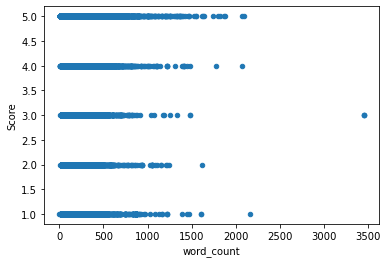

In [21]:
train.plot(kind="scatter", x="word_count", y="Score")

In [20]:
# scatter plot

Displaying the scatter plot for score v/s review length

<AxesSubplot:xlabel='review_len', ylabel='Score'>

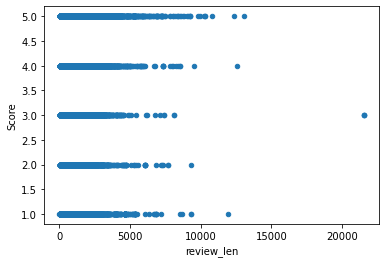

In [22]:
train.plot(kind="scatter", x="review_len", y="Score")

The lenghth of most reviews come in the range of 10,000

The above plots are scatter plots to view the relation between the score and the word count and also with 
the review length.
From these graph we have two observations:
1. Most of the review that are under the review score of 5 have around 1500 words.
2. There is a single review among all the reviews that belong to a score rating of 3 which has around 3500 words.


# PART 2- Text Processing and Normalization

Experiments with different text processing and normalization alternatives.


In [23]:
# IF DUPLICATE ROWS ARE NOT DELETED IT WILL LEAD TO HIGH ACCURACIES SCORES WHILE TRAINING data and will lead to overfittimg of the data
train.duplicated(['Review_text']).tolist()
print(train.count(True))

0         4
1         4
2         4
3         4
4         4
         ..
426335    4
426336    4
426337    4
426338    4
426339    4
Length: 426340, dtype: int64


Checking the data before removing the duplicates

In [24]:
# check
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426340 entries, 0 to 426339
Data columns (total 4 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Score        426340 non-null  int64 
 1   Review_text  426340 non-null  object
 2   review_len   426340 non-null  int64 
 3   word_count   426340 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 13.0+ MB


Dropping the duplicate columns

In [25]:
train.drop_duplicates(['Review_text'],inplace=True)

Checking the data after removing the duplicates

In [27]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 308907 entries, 0 to 426338
Data columns (total 4 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Score        308907 non-null  int64 
 1   Review_text  308907 non-null  object
 2   review_len   308907 non-null  int64 
 3   word_count   308907 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 11.8+ MB


In [28]:
# NEW DATA  AFTER REMOVING DUPLICATE ROWS
train.head(50)

,Score,Review_text,review_len,word_count
0,5,I received this product early from the seller!...,207,40
1,5,*****<br />Numi's Collection Assortment Melang...,1998,319
2,5,"I was very careful not to overcook this pasta,...",1146,204
3,5,Buying this multi-pack I was misled by the pic...,201,34
4,5,These bars are so good! I loved them warmed up...,164,29
5,5,"I love these chips, I buy the 24 pack once a m...",274,53
6,5,I'm a huge fan of eating cereal for breakfast....,629,127
7,2,I was really disappointed with the Sorghum we ...,305,52
8,3,A friend who has gone to Korea gave me a coupl...,554,109
9,4,No need for plastic baggies or sloppy tin foil...,379,70


Downloading the NLTK libraries

In [29]:
import nltk
nltk.download('omw-1.4')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


 Listing out the contradictions words

In [31]:
contractions_dict = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have",
    
    
}

Function that finds the contradiction words and replaces it with the expanded form

In [32]:
# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))
def expand_contractions(Review_text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, Review_text)
# Expanding Contractions in the reviews
train['Review_text']=train['Review_text'].apply(lambda x:expand_contractions(x))

A function is created to remove hyperlinks, '@' mentions, # symbols and alphanumeric characters. Then the tweets are tokenised and lemmatized.
Here we used lemmatizing of tweets instead of stemming since when we use the stemming of tweets, the last part of the words get removed. For eg: cries or crying become cry, tries or trying become try etc. So the words do not have any meaning after stemming.
We are tokenising after cleaning and before labelling the data since few words were getting cut off, so the labeeling would not happen properly.

In [33]:
# cleaninng Reviews
Reviews = train['Review_text']

def preprocess_Reviews_text(Reviews):
    Reviews = Reviews.lower() #lowercase
    Reviews = re.sub("<br />",'',Reviews) #Removing </br>
    Reviews = re.sub("<a href='https?:\/\/\S+> </a>",'', Reviews)
    Reviews = re.sub(r'#','',Reviews) # Removing # symbol 
    Reviews = re.sub('[%s]' % re.escape(string.punctuation), '' , Reviews) #remove punctuation like '!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~'
    Reviews = re.sub('(http[s]?S+)|(w+.[A-Za-z]{2,4}S*)', '', Reviews) # remove url
    Reviews = re.sub("[^a-z0-9]"," ", Reviews) #Remove alphanumeric
    tweet_tokens = word_tokenize(Reviews) # tokenise & stop word removal
    filtered_words = [word for word in tweet_tokens if word not in stop_words]
    lemetizer = WordNetLemmatizer() # lemmatize
    lemma_words = [lemetizer.lemmatize(w,pos='a') for w in filtered_words]
    return " ".join(lemma_words)

train['Review_text'] = train['Review_text'].apply(preprocess_Reviews_text)
train.head(10)

,Score,Review_text,review_len,word_count
0,5,received product early seller tastey great mid...,207,40
1,5,numis collection assortment melange includes5 ...,1998,319
2,5,careful overcook pasta making sure take bite e...,1146,204
3,5,buying multipack misled picture hazel nuts ano...,201,34
4,5,bars good loved definitely think great snack b...,164,29
5,5,love chips buy 24 pack month bags right size s...,274,53
6,5,huge fan eating cereal breakfast light tastes ...,629,127
7,2,really disappointed sorghum purchased users 50...,305,52
8,3,friend gone korea gave couple packs try found ...,554,109
9,4,need plastic baggies sloppy tin foil rs honey ...,379,70


In [34]:
train.loc[107,'Review_text']

'ful fresh natural juice added sugar use agave enough love pure passion fruit juice juices advertised passion fruit mostly pear apple juice splash passion fruit great product great price'

DATA LABELLING

In [35]:
train.head()

,Score,Review_text,review_len,word_count
0,5,received product early seller tastey great mid...,207,40
1,5,numis collection assortment melange includes5 ...,1998,319
2,5,careful overcook pasta making sure take bite e...,1146,204
3,5,buying multipack misled picture hazel nuts ano...,201,34
4,5,bars good loved definitely think great snack b...,164,29


In [154]:
! pip install --upgrade pip

In [ ]:
! pip install wordcloud


In [36]:
df_5=train[train['Score']==5]
df_5

,Score,Review_text,review_len,word_count
0,5,received product early seller tastey great mid...,207,40
1,5,numis collection assortment melange includes5 ...,1998,319
2,5,careful overcook pasta making sure take bite e...,1146,204
3,5,buying multipack misled picture hazel nuts ano...,201,34
4,5,bars good loved definitely think great snack b...,164,29
...,...,...,...,...
426327,5,sale thought try much surprise family loved st...,246,51
426331,5,coconut tastes great first time tried tasted s...,562,102
426333,5,one loves dirty ketel one grey goose martini s...,336,63
426335,5,buying store hard time keeping stockmy dogs al...,868,164


The word cloud visualization is used for showing which keyword has the highest freqency.

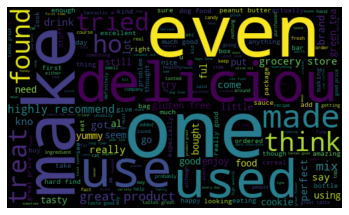

In [34]:
#Word Cloud
import matplotlib.pyplot as plt
from wordcloud import WordCloud

allwords = ' '.join(Reviews for Reviews in df_5['Review_text'])
wordCloud = WordCloud(width=500,height=300,random_state = 21,max_font_size=119).generate(allwords)

plt.imshow(wordCloud,interpolation = "bilinear")
plt.axis('off')
plt.show()

As we see the image from the wordcloud above, we see that 'one' is the biggest in size and 'even' comes after that. In word cloud, the bigger the size means that the key word is more frequent in occuring in the dataset.

# Part 3- Vector space Model and feature representation &      Part 4- Model training, selection and hyperparameter tuning and evaluation



Experiments with different representation techniques and experimenting with 3 models and showing how we can optimize model parameters using cross validation.


Using the seaborn classifiers, we are creating the visualisation code for classification report, confusion matrix, ROC curve. We are using a function here so that we can pass the model to this function to get the visualization data and the accuracy score of each model.

In [37]:
# a common function for building confusion matrix and classification report once the model passed into the function
from sklearn.metrics import classification_report,confusion_matrix
import seaborn as sns
import numpy as np

def model_Evaluate(model):
  # Predict values for Test dataset
  y_pred = model.predict(X_test)
  # Print the evaluation metrics for the dataset.
  print(classification_report(y_test, y_pred))
  # Compute and plot the Confusion matrix
  cf_matrix = confusion_matrix(y_test, y_pred)
  categories = ['1','2','3','4','5']
  group_names = ['True Neg','False Pos', 'False Neg','True Pos']
  group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten() / np.sum(cf_matrix)]
  labels = [f'{v1}n{v2}' for v1, v2 in zip(group_names,group_percentages)]
  labels = np.asarray(labels).reshape(2,2)
  sns.heatmap(cf_matrix, annot = True, cmap = 'Blues',fmt = '',
  xticklabels = categories, yticklabels = categories)
  plt.xlabel("Predicted values", fontdict = {'size':14}, labelpad = 10)
  plt.ylabel("Actual values" , fontdict = {'size':14}, labelpad = 10)
  plt.title ("Confusion Matrix", fontdict = {'size':18}, pad = 20)


# 1. Binary vectorizer with classifier Logistic Regression, MultinomialNB, DecisionTreeClassifier

The first text representation is the Binary vectorizer

Using binary vectorization, we take a corpus, or a unique list of all words that show up in our review data, and generate a vector of 1s and 0s, where a 1 indicates the presence of a word and a 0 indicates the absence of a word.

In [38]:
from sklearn.preprocessing import Binarizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split

Here the attribute is the text reviews, which are the reviews in the dataset and the target is the score, which are the review scores of the text reviews. We then do a 80:20 train split.

In [40]:
#Splitting the dataset into training and test set
att = train['Review_text']
target = train['Score']
X_train, X_test, y_train, y_test = train_test_split(att,target,test_size=0.2,random_state=404,shuffle=True)

In [41]:
B_vectoriser = CountVectorizer(binary=True)
B_vectoriser.fit(X_train)
B_vectoriser.fit(X_test)
print('No. of feature_words: ', len(B_vectoriser.get_feature_names()))

X_train = B_vectoriser.transform(X_train)
X_test  = B_vectoriser.transform(X_test)

No. of feature_words:  96281


In [42]:
feature_names = B_vectoriser.get_feature_names()
# get_feature_name method returns a list where each entry corresponds to one feature:
print("Number of features: {}".format(len(feature_names))) # How many total features?
print("First 20 features:\n{}".format(feature_names[:20])) # Print feature name in range
print("Features 20010 to 20030:\n{}".format(feature_names[20010:20030]))
print("Every 2000th feature:\n{}".format(feature_names[::2000]))
#Q11 Explore with printing out different ranges/values of features and thing of what cleaning steps would make sense in this application


Number of features: 96281
First 20 features:
['00', '0000', '00001', '001', '00100', '002', '0035', '0039', '00493a', '004oz', '005', '006', '007', '0080vitamin', '009', '00g', '00size', '01', '010', '010308']
Features 20010 to 20030:
['cloum', 'cloured', 'clousen', 'clove', 'clovelooks', 'cloveoregano', 'clover', 'cloverdale', 'cloves', 'clovesbecause', 'clovesi', 'clovesnicely', 'clovethis', 'clovetinged', 'clovey', 'clown', 'cloyed', 'cloying', 'cloyingly', 'cloyingrich']
Every 2000th feature:
['00', '2366', '689', 'aftertaste', 'anse', 'babythe', 'bestsmelling', 'boxits', 'calor', 'charitable', 'clots', 'containersjars', 'culturally', 'deschanel', 'doityourself', 'ejected', 'exhusband', 'fevertree', 'foreveris', 'genius', 'greenies', 'heathy', 'hrefhttpncomgpproductb0002ml7s0premium', 'illa', 'isan', 'kicki', 'lid500', 'madeit', 'menurecipe', 'moose', 'nephews', 'nutmegs', 'ordinarycoffee', 'passesnothing', 'plantplanter', 'priceorijen', 'quiero', 'remembering', 'rtf', 'secretfor',

Initializing the classifers that will be used in each text representations

In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV


In [44]:
# getting the parameters of  lr
lr = LogisticRegression()
print(lr.get_params().keys())

dict_keys(['C', 'class_weight', 'dual', 'fit_intercept', 'intercept_scaling', 'l1_ratio', 'max_iter', 'multi_class', 'n_jobs', 'penalty', 'random_state', 'solver', 'tol', 'verbose', 'warm_start'])


In [45]:
# getting the parameters of  nb
nb = MultinomialNB()
print(nb.get_params().keys())

dict_keys(['alpha', 'class_prior', 'fit_prior'])


In [46]:
# getting the parameters of  nb
dt = DecisionTreeClassifier()
print(dt.get_params().keys())   


dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])


# Hyperparameter tuning

Hyperparameter tuning is choosing a set of optimal hyperparameters for a learning algorithm.

We are using logistic regression, decision trees classifier and multinomial naive bayes models to train and test the dataset and also get the accuracy of all three classifiers using grid search

The code below is used for finding out which is the best classifiers among the three classifiers. This does cross validation search of 10 times for each classifiers looking at different parameters.

In [51]:
# Set grid search params
param_range = [9, 10]
param_range_fl = [1.0, 0.5]
param_alpha = [1, 0.1] 


grid_params_lr = [{'penalty': ['l1', 'l2'],
                   'C': param_range_fl,
                   'solver': ['liblinear']}] 

grid_params_nb = [{'alpha': param_alpha,
                   'fit_prior': [True, False]}] 

grid_params_dt = [{'criterion': ['gini', 'entropy'],
                   'max_depth': param_range,
                   'min_samples_split': param_range[1:]}] 



# Construct grid searches
jobs = -1

LR = GridSearchCV(estimator=LogisticRegression(),
            param_grid=grid_params_lr,
            scoring='accuracy',
            cv=3) 


NB = GridSearchCV(estimator=MultinomialNB(),
            param_grid=grid_params_nb,
            scoring='accuracy',
            cv=3) 

DT = GridSearchCV(estimator=DecisionTreeClassifier(),
            param_grid=grid_params_dt,
            scoring='accuracy',
            cv=3)




# List of pipelines for iterating through each of them
grids = [LR,NB,DT]

# Creating a dict for our reference
grid_dict = {0: 'Logistic Regression', 
             1: 'NB',
             2: 'DT'}

# Fit the grid search objects
print('Performing model optimizations...')
best_acc = 0.0
best_clf = 0
best_gs = ''
for idx, gs in enumerate(grids):
    print('\nEstimator: %s' % grid_dict[idx])
    gs.fit(X_train, y_train)
    print('Best params are : %s' % gs.best_params_)
    # Best training data accuracy
    print('Best training accuracy: %.3f' % gs.best_score_)
    # Predict on test data with best params
    y_pred = gs.predict(X_test)
    # Test data accuracy of model with best params
    print('Test set accuracy score for best params: %.3f ' % accuracy_score(y_test, y_pred))
    # Track best (highest test accuracy) model
    if accuracy_score(y_test, y_pred) > best_acc:
        best_acc = accuracy_score(y_test, y_pred)
        best_gs = gs
        best_clf = idx
print('\nClassifier with best test set accuracy: %s' % grid_dict[best_clf])



Performing model optimizations...

Estimator: Logistic Regression
Best params are : {'C': 0.5, 'penalty': 'l1', 'solver': 'liblinear'}
Best training accuracy: 0.724
Test set accuracy score for best params: 0.726 

Estimator: NB
Best params are : {'alpha': 1, 'fit_prior': True}
Best training accuracy: 0.699
Test set accuracy score for best params: 0.674 

Estimator: DT
Best params are : {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 10}
Best training accuracy: 0.650
Test set accuracy score for best params: 0.650 

Classifier with best test set accuracy: Logistic Regression


From this we can conclude that Logistic Regression has the best accuracy among the three with an accuracy of 72.6%

Displaying the confusion matrix and classification report. We pass on the model to the function we created to get the visualization of the confusion matrix.

              precision    recall  f1-score   support

           1       0.62      0.67      0.64      5646
           2       0.33      0.19      0.24      3286
           3       0.41      0.26      0.32      4627
           4       0.43      0.26      0.32      8836
           5       0.81      0.93      0.86     39387

    accuracy                           0.72     61782
   macro avg       0.52      0.46      0.48     61782
weighted avg       0.68      0.72      0.69     61782



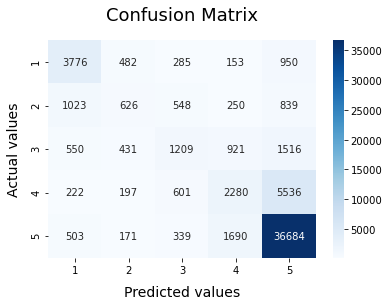

In [71]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF LogisticRegression
lr = LogisticRegression()
lr.fit(X_train, y_train)
model_Evaluate(lr)


From the classification report of the logistic regression, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 81% of the time, the classifier predicts score 5 correctly.

              precision    recall  f1-score   support

           1       0.76      0.11      0.19      5646
           2       0.00      0.00      0.00      3286
           3       0.06      0.00      0.00      4627
           4       0.30      0.01      0.02      8836
           5       0.65      1.00      0.78     39387

    accuracy                           0.65     61782
   macro avg       0.35      0.22      0.20     61782
weighted avg       0.53      0.65      0.52     61782



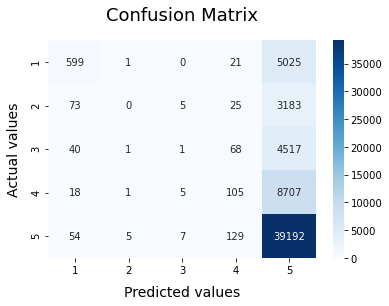

In [87]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF MultinomialNB
nb = MultinomialNB()
nb.fit(X_train, y_train)
model_Evaluate(nb)


From the classification report of the Multinomial NB, according to the precision scores we see that the predicted values of score 1 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 1 correctly.

              precision    recall  f1-score   support

           1       0.44      0.43      0.43      5646
           2       0.16      0.13      0.14      3286
           3       0.22      0.20      0.21      4627
           4       0.26      0.22      0.24      8836
           5       0.76      0.81      0.79     39387

    accuracy                           0.61     61782
   macro avg       0.37      0.36      0.36     61782
weighted avg       0.59      0.61      0.60     61782



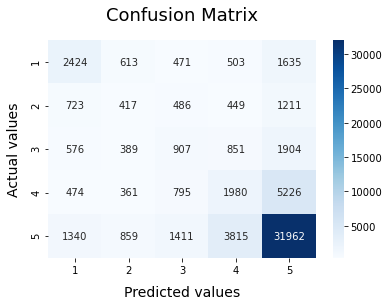

In [77]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
model_Evaluate(dt)


From the classification report of the Decision trees classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 5 correctly.

# 2.CountVectorizer(FREQUENCY COUNT) Logistic Regression, MultinomialNB, DecisionTreeClassifier

The second text representation is the Countvectorizer

Count Vectorizer is a great tool provided by the scikit-learn library in Python. It is used to transform a given text into a vector on the basis of the frequency (count) of each word that occurs in the entire text.

In [45]:
from sklearn.feature_extraction.text import CountVectorizer

In [46]:
train.head(5)

,Score,Review_text,review_len,word_count
0,5,received product early seller tastey great mid...,207,40
1,5,numis collection assortment melange includes5 ...,1998,319
2,5,careful overcook pasta making sure take bite e...,1146,204
3,5,buying multipack misled picture hazel nuts ano...,201,34
4,5,bars good loved definitely think great snack b...,164,29


Here the attribute is the text reviews, which are the reviews in the dataset and the target is the score, which are the review scores of the text reviews. We then do a 80:20 train split.

In [47]:
#Splitting the dataset into training and test set
att = train['Review_text']
target = train['Score']
X_train, X_test, y_train, y_test = train_test_split(att,target,test_size=0.2,random_state=404,shuffle=True)

In [48]:
C_vectoriser = CountVectorizer()
C_vectoriser.fit(X_train)
C_vectoriser.fit(X_test)
print('No. of feature_words: ', len(C_vectoriser.get_feature_names()))

X_train = C_vectoriser.transform(X_train)
X_test  = C_vectoriser.transform(X_test)

No. of feature_words:  96281


In [49]:
feature_names = C_vectoriser.get_feature_names()
# get_feature_name method returns a list where each entry corresponds to one feature:
print("Number of features: {}".format(len(feature_names))) # How many total features?
print("First 20 features:\n{}".format(feature_names[:20])) # Print feature name in range
print("Features 20010 to 20030:\n{}".format(feature_names[20010:20030]))
print("Every 2000th feature:\n{}".format(feature_names[::2000]))
#Q11 Explore with printing out different ranges/values of features and thing of what cleaning steps would make sense in this application


Number of features: 96281
First 20 features:
['00', '0000', '00001', '001', '00100', '002', '0035', '0039', '00493a', '004oz', '005', '006', '007', '0080vitamin', '009', '00g', '00size', '01', '010', '010308']
Features 20010 to 20030:
['cloum', 'cloured', 'clousen', 'clove', 'clovelooks', 'cloveoregano', 'clover', 'cloverdale', 'cloves', 'clovesbecause', 'clovesi', 'clovesnicely', 'clovethis', 'clovetinged', 'clovey', 'clown', 'cloyed', 'cloying', 'cloyingly', 'cloyingrich']
Every 2000th feature:
['00', '2366', '689', 'aftertaste', 'anse', 'babythe', 'bestsmelling', 'boxits', 'calor', 'charitable', 'clots', 'containersjars', 'culturally', 'deschanel', 'doityourself', 'ejected', 'exhusband', 'fevertree', 'foreveris', 'genius', 'greenies', 'heathy', 'hrefhttpncomgpproductb0002ml7s0premium', 'illa', 'isan', 'kicki', 'lid500', 'madeit', 'menurecipe', 'moose', 'nephews', 'nutmegs', 'ordinarycoffee', 'passesnothing', 'plantplanter', 'priceorijen', 'quiero', 'remembering', 'rtf', 'secretfor',

In [50]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

In [80]:
X_train.shape

(247125, 96281)

In [81]:
y_train.shape

(247125,)

# Hyperparameter tuning

The code below is used for finding out which is the best classifiers among the three classifiers. This does cross validation search of 10 times for each classifiers looking at different parameters.

In [82]:
# Set grid search params
param_range = [9, 10]
param_range_fl = [1.0, 0.5]
param_alpha = [1, 0.1] 


grid_params_lr = [{'penalty': ['l1', 'l2'],
                   'C': param_range_fl,
                   'solver': ['liblinear']}] 

grid_params_nb = [{'alpha': param_alpha,
                   'fit_prior': [True, False]}] 

grid_params_dt = [{'criterion': ['gini', 'entropy'],
                   'max_depth': param_range,
                   'min_samples_split': param_range[1:]}] 



# Construct grid searches
jobs = -1

LR = GridSearchCV(estimator=LogisticRegression(),
            param_grid=grid_params_lr,
            scoring='accuracy',
            cv=3) 


NB = GridSearchCV(estimator=MultinomialNB(),
            param_grid=grid_params_nb,
            scoring='accuracy',
            cv=3) 

DT = GridSearchCV(estimator=DecisionTreeClassifier(),
            param_grid=grid_params_dt,
            scoring='accuracy',
            cv=3)



# List of pipelines for iterating through each of them
grids = [LR,NB,DT]

# Creating a dict for our reference
grid_dict = {0: 'Logistic Regression', 
             1: 'MultinomialNB',
             2: 'DecisionTreeClassifier'}

# Fit the grid search objects
print('Performing model optimizations...')
best_acc = 0.0
best_clf = 0
best_gs = ''
for idx, gs in enumerate(grids):
    print('\nEstimator: %s' % grid_dict[idx])
    gs.fit(X_train, y_train)
    print('Best params are : %s' % gs.best_params_)
    # Best training data accuracy
    print('Best training accuracy: %.3f' % gs.best_score_)
    # Predict on test data with best params
    y_pred = gs.predict(X_test)
    # Test data accuracy of model with best params
    print('Test set accuracy score for best params: %.3f ' % accuracy_score(y_test, y_pred))
    # Track best (highest test accuracy) model
    if accuracy_score(y_test, y_pred) > best_acc:
        best_acc = accuracy_score(y_test, y_pred)
        best_gs = gs
        best_clf = idx
print('\nClassifier with best test set accuracy: %s' % grid_dict[best_clf])



Performing model optimizations...

Estimator: Logistic Regression
Best params are : {'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}
Best training accuracy: 0.727
Test set accuracy score for best params: 0.731 

Estimator: MultinomialNB
Best params are : {'alpha': 0.1, 'fit_prior': True}
Best training accuracy: 0.670
Test set accuracy score for best params: 0.674 

Estimator: DecisionTreeClassifier
Best params are : {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 10}
Best training accuracy: 0.650
Test set accuracy score for best params: 0.646 

Classifier with best test set accuracy: Logistic Regression


From this we can conclude that Logistic Regression has the best accuracy among the three with an accuracy of 73.1%.

Displaying the confusion matrix and classification report. We pass on the model to the function we created to get the visualization of the confusion matrix.

              precision    recall  f1-score   support

           1       0.65      0.67      0.66      5646
           2       0.42      0.16      0.23      3286
           3       0.44      0.28      0.34      4627
           4       0.48      0.22      0.30      8836
           5       0.79      0.96      0.87     39387

    accuracy                           0.73     61782
   macro avg       0.56      0.46      0.48     61782
weighted avg       0.69      0.73      0.69     61782



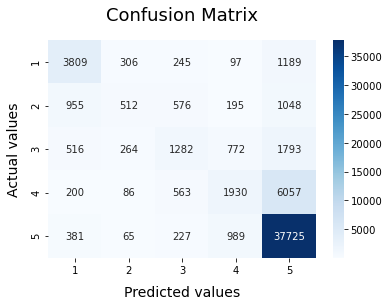

In [88]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF LogisticRegression
lr = LogisticRegression()
lr.fit(X_train, y_train)
model_Evaluate(lr)

From the classification report of the logistic regression classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 79% of the time, the classifier predicts score 5 correctly.

              precision    recall  f1-score   support

           1       0.76      0.11      0.19      5646
           2       0.00      0.00      0.00      3286
           3       0.06      0.00      0.00      4627
           4       0.30      0.01      0.02      8836
           5       0.65      1.00      0.78     39387

    accuracy                           0.65     61782
   macro avg       0.35      0.22      0.20     61782
weighted avg       0.53      0.65      0.52     61782



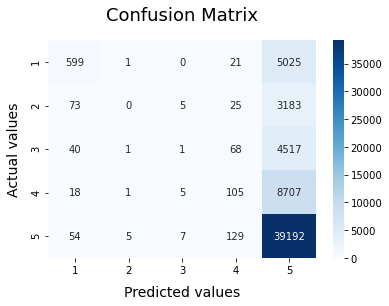

In [89]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF MultinomialNB
nb = MultinomialNB()
nb.fit(X_train, y_train)
model_Evaluate(nb)

From the classification report of the multinomial NB classifier, according to the precision scores we see that the predicted values of score 1 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 1 correctly.

              precision    recall  f1-score   support

           1       0.43      0.43      0.43      5646
           2       0.16      0.12      0.14      3286
           3       0.22      0.18      0.20      4627
           4       0.27      0.23      0.25      8836
           5       0.76      0.81      0.79     39387

    accuracy                           0.61     61782
   macro avg       0.37      0.36      0.36     61782
weighted avg       0.59      0.61      0.60     61782



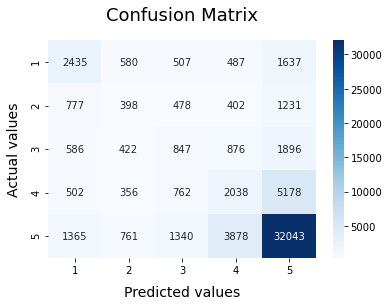

In [51]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
model_Evaluate(dt)

From the classification report of the Decision trees classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 5 correctly.

# TF-IDF VECTORIZER Logistic Regression, MultinomialNB, DecisionTreeClassifier

The third text representation is the TF-IDF vectorizer

Term frequency-inverse document frequency is a text vectorizer that transforms the text into a usable vector

In [53]:
from sklearn.feature_extraction.text import TfidfVectorizer

Here the attribute is the text reviews, which are the reviews in the dataset and the target is the score, which are the review scores of the text reviews. We then do a 80:20 train split.

In [54]:
#Splitting the dataset into training and test set
att = train['Review_text']
target = train['Score']
X_train, X_test, y_train, y_test = train_test_split(att,target,test_size=0.2,random_state=404,shuffle=True)

In [55]:
t_vectoriser = TfidfVectorizer(max_features=500000)
t_vectoriser.fit(X_train)
t_vectoriser.fit(X_test)
print('No. of feature_words: ', len(t_vectoriser.get_feature_names()))

X_train = t_vectoriser.transform(X_train)
X_test  = t_vectoriser.transform(X_test)

No. of feature_words:  96281


In [56]:
feature_names = t_vectoriser.get_feature_names()
# get_feature_name method returns a list where each entry corresponds to one feature:
print("Number of features: {}".format(len(feature_names))) # How many total features?
print("First 20 features:\n{}".format(feature_names[:20])) # Print feature name in range
print("Features 20010 to 20030:\n{}".format(feature_names[20010:20030]))
print("Every 2000th feature:\n{}".format(feature_names[::2000]))
#Q11 Explore with printing out different ranges/values of features and thing of what cleaning steps would make sense in this application


Number of features: 96281
First 20 features:
['00', '0000', '00001', '001', '00100', '002', '0035', '0039', '00493a', '004oz', '005', '006', '007', '0080vitamin', '009', '00g', '00size', '01', '010', '010308']
Features 20010 to 20030:
['cloum', 'cloured', 'clousen', 'clove', 'clovelooks', 'cloveoregano', 'clover', 'cloverdale', 'cloves', 'clovesbecause', 'clovesi', 'clovesnicely', 'clovethis', 'clovetinged', 'clovey', 'clown', 'cloyed', 'cloying', 'cloyingly', 'cloyingrich']
Every 2000th feature:
['00', '2366', '689', 'aftertaste', 'anse', 'babythe', 'bestsmelling', 'boxits', 'calor', 'charitable', 'clots', 'containersjars', 'culturally', 'deschanel', 'doityourself', 'ejected', 'exhusband', 'fevertree', 'foreveris', 'genius', 'greenies', 'heathy', 'hrefhttpncomgpproductb0002ml7s0premium', 'illa', 'isan', 'kicki', 'lid500', 'madeit', 'menurecipe', 'moose', 'nephews', 'nutmegs', 'ordinarycoffee', 'passesnothing', 'plantplanter', 'priceorijen', 'quiero', 'remembering', 'rtf', 'secretfor',

# Hyperparameter tuning

The code below is used for finding out which is the best classifiers among the three classifiers. This does cross validation search of 10 times for each classifiers looking at different parameters.

In [91]:
# Set grid search params
param_range = [9, 10]
param_range_fl = [1.0, 0.5]
param_alpha = [1, 0.1] 


grid_params_lr = [{'penalty': ['l1', 'l2'],
                   'C': param_range_fl,
                   'solver': ['liblinear']}] 

grid_params_nb = [{'alpha': param_alpha,
                   'fit_prior': [True, False]}] 

grid_params_dt = [{'criterion': ['gini', 'entropy'],
                   'max_depth': param_range,
                   'min_samples_split': param_range[1:]}] 



# Construct grid searches
jobs = -1

LR = GridSearchCV(estimator=LogisticRegression(),
            param_grid=grid_params_lr,
            scoring='accuracy',
            cv=3) 


NB = GridSearchCV(estimator=MultinomialNB(),
            param_grid=grid_params_nb,
            scoring='accuracy',
            cv=3) 

DT = GridSearchCV(estimator=DecisionTreeClassifier(),
            param_grid=grid_params_dt,
            scoring='accuracy',
            cv=3)



# List of pipelines for iterating through each of them
grids = [LR,NB,DT]

# Creating a dict for our reference
grid_dict = {0: 'Logistic Regression', 
             1: 'MultinomialNB',
             2: 'DecisionTreeClassifier'}

# Fit the grid search objects
print('Performing model optimizations...')
best_acc = 0.0
best_clf = 0
best_gs = ''
for idx, gs in enumerate(grids):
    print('\nEstimator: %s' % grid_dict[idx])
    gs.fit(X_train, y_train)
    print('Best params are : %s' % gs.best_params_)
    # Best training data accuracy
    print('Best training accuracy: %.3f' % gs.best_score_)
    # Predict on test data with best params
    y_pred = gs.predict(X_test)
    # Test data accuracy of model with best params
    print('Test set accuracy score for best params: %.3f ' % accuracy_score(y_test, y_pred))
    # Track best (highest test accuracy) model
    if accuracy_score(y_test, y_pred) > best_acc:
        best_acc = accuracy_score(y_test, y_pred)
        best_gs = gs
        best_clf = idx
print('\nClassifier with best test set accuracy: %s' % grid_dict[best_clf])



Performing model optimizations...

Estimator: Logistic Regression
Best params are : {'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}
Best training accuracy: 0.727
Test set accuracy score for best params: 0.731 

Estimator: MultinomialNB
Best params are : {'alpha': 0.1, 'fit_prior': True}
Best training accuracy: 0.670
Test set accuracy score for best params: 0.674 

Estimator: DecisionTreeClassifier
Best params are : {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 10}
Best training accuracy: 0.650
Test set accuracy score for best params: 0.646 

Classifier with best test set accuracy: Logistic Regression


From this we can conclude that Logistic Regression has the best accuracy among the three with an accuracy of 73.1%.

Displaying the confusion matrix and classification report. We pass on the model to the function we created to get the visualization of the confusion matrix.

              precision    recall  f1-score   support

           1       0.65      0.67      0.66      5646
           2       0.42      0.16      0.23      3286
           3       0.44      0.28      0.34      4627
           4       0.48      0.22      0.30      8836
           5       0.79      0.96      0.87     39387

    accuracy                           0.73     61782
   macro avg       0.56      0.46      0.48     61782
weighted avg       0.69      0.73      0.69     61782



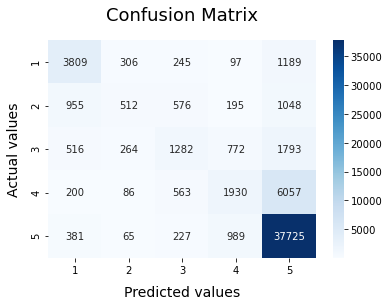

In [57]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF LogisticRegression
lr = LogisticRegression()
lr.fit(X_train, y_train)
model_Evaluate(lr)

From the classification report of the logistic regression classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 79% of the time, the classifier predicts score 5 correctly.

              precision    recall  f1-score   support

           1       0.76      0.11      0.19      5646
           2       0.00      0.00      0.00      3286
           3       0.06      0.00      0.00      4627
           4       0.30      0.01      0.02      8836
           5       0.65      1.00      0.78     39387

    accuracy                           0.65     61782
   macro avg       0.35      0.22      0.20     61782
weighted avg       0.53      0.65      0.52     61782



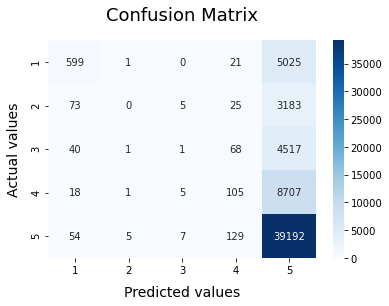

In [58]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF MultinomialNB
nb = MultinomialNB()
nb.fit(X_train, y_train)
model_Evaluate(nb)


From the classification report of the multinomial NB classifier, according to the precision scores we see that the predicted values of score 1 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 1 correctly.

              precision    recall  f1-score   support

           1       0.42      0.43      0.42      5646
           2       0.15      0.12      0.13      3286
           3       0.22      0.19      0.20      4627
           4       0.25      0.22      0.23      8836
           5       0.76      0.80      0.78     39387

    accuracy                           0.60     61782
   macro avg       0.36      0.35      0.36     61782
weighted avg       0.58      0.60      0.59     61782



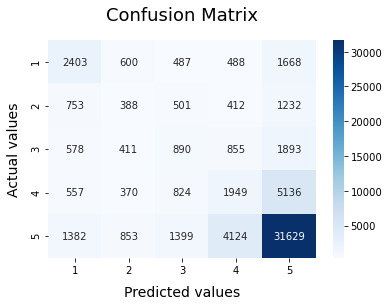

In [59]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
model_Evaluate(dt)


From the classification report of the Decision trees classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 5 correctly.

# UNIGRAM FEATURES Logistic Regression, MultinomialNB, DecisionTreeClassifier

The fourth text representation is the Unigram

1-gram (or unigram) is a one-word sequence. A model that simply relies on how often a word occurs without looking at previous words is called a unigram model.

In [65]:
from sklearn.feature_extraction.text import TfidfVectorizer

Here the attribute is the text reviews, which are the reviews in the dataset and the target is the score, which are the review scores of the text reviews. We then do a 80:20 train split.

In [66]:
#Splitting the dataset into training and test set
att = train['Review_text']
target = train['Score']
X_train, X_test, y_train, y_test = train_test_split(att,target,test_size=0.2,random_state=404,shuffle=True)

In [67]:
u_vectoriser = TfidfVectorizer(ngram_range=(1,1), max_features=80000)
u_vectoriser.fit(X_train)
u_vectoriser.fit(X_test)
print('No. of feature_words: ', len(u_vectoriser.get_feature_names()))

X_train = u_vectoriser.transform(X_train)
X_test  = u_vectoriser.transform(X_test)

No. of feature_words:  80000


In [68]:
feature_names = u_vectoriser.get_feature_names()
# get_feature_name method returns a list where each entry corresponds to one feature:
print("Number of features: {}".format(len(feature_names))) # How many total features?
print("First 20 features:\n{}".format(feature_names[:20])) # Print feature name in range
print("Features 20010 to 20030:\n{}".format(feature_names[20010:20030]))
print("Every 2000th feature:\n{}".format(feature_names[::2000]))
#Q11 Explore with printing out different ranges/values of features and thing of what cleaning steps would make sense in this application


Number of features: 80000
First 20 features:
['00', '0000', '00001', '001', '00100', '002', '0035', '0039', '00493a', '004oz', '005', '006', '007', '0080vitamin', '009', '00g', '00size', '01', '010', '010308']
Features 20010 to 20030:
['cloum', 'cloured', 'clousen', 'clove', 'clovelooks', 'cloveoregano', 'clover', 'cloverdale', 'cloves', 'clovesbecause', 'clovesi', 'clovesnicely', 'clovethis', 'clovetinged', 'clovey', 'clown', 'cloyed', 'cloying', 'cloyingly', 'cloyingrich']
Every 2000th feature:
['00', '2366', '689', 'aftertaste', 'anse', 'babythe', 'bestsmelling', 'boxits', 'calor', 'charitable', 'clots', 'containersjars', 'culturally', 'deschanel', 'doityourself', 'enjoyableit', 'formulasthere', 'harvey', 'interestedso', 'kadota', 'lids', 'mixedbreed', 'ngin', 'oatsthe', 'otes', 'pba', 'plus', 'problemsthe', 'raisinfree', 'reputation', 'saddens', 'sellerit', 'situationsmood', 'souri', 'stoppedho', 'syptoms', 'thatto', 'tomatosaltdicalcium', 'ultrahealthy', 'vero']


# Hyperparameter tuning

The code below is used for finding out which is the best classifiers among the three classifiers. This does cross validation search of 10 times for each classifiers looking at different parameters.

In [68]:
# Set grid search params
param_range = [9, 10]
param_range_fl = [1.0, 0.5]
param_alpha = [1, 0.1] 


grid_params_lr = [{'penalty': ['l1', 'l2'],
                   'C': param_range_fl,
                   'solver': ['liblinear']}] 

grid_params_nb = [{'alpha': param_alpha,
                   'fit_prior': [True, False]}] 

grid_params_dt = [{'criterion': ['gini', 'entropy'],
                   'max_depth': param_range,
                   'min_samples_split': param_range[1:]}] 



# Construct grid searches
jobs = -1

LR = GridSearchCV(estimator=LogisticRegression(),
            param_grid=grid_params_lr,
            scoring='accuracy',
            cv=3) 


NB = GridSearchCV(estimator=MultinomialNB(),
            param_grid=grid_params_nb,
            scoring='accuracy',
            cv=3) 

DT = GridSearchCV(estimator=DecisionTreeClassifier(),
            param_grid=grid_params_dt,
            scoring='accuracy',
            cv=3)



# List of pipelines for iterating through each of them
grids = [LR,NB,DT]

# Creating a dict for our reference
grid_dict = {0: 'Logistic Regression', 
             1: 'MultinomialNB',
             2: 'DecisionTreeClassifier'}

# Fit the grid search objects
print('Performing model optimizations...')
best_acc = 0.0
best_clf = 0
best_gs = ''
for idx, gs in enumerate(grids):
    print('\nEstimator: %s' % grid_dict[idx])
    gs.fit(X_train, y_train)
    print('Best params are : %s' % gs.best_params_)
    # Best training data accuracy
    print('Best training accuracy: %.3f' % gs.best_score_)
    # Predict on test data with best params
    y_pred = gs.predict(X_test)
    # Test data accuracy of model with best params
    print('Test set accuracy score for best params: %.3f ' % accuracy_score(y_test, y_pred))
    # Track best (highest test accuracy) model
    if accuracy_score(y_test, y_pred) > best_acc:
        best_acc = accuracy_score(y_test, y_pred)
        best_gs = gs
        best_clf = idx
print('\nClassifier with best test set accuracy: %s' % grid_dict[best_clf])



Performing model optimizations...

Estimator: Logistic Regression
Best params are : {'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}
Best training accuracy: 0.727
Test set accuracy score for best params: 0.731 

Estimator: MultinomialNB
Best params are : {'alpha': 0.1, 'fit_prior': True}
Best training accuracy: 0.671
Test set accuracy score for best params: 0.676 

Estimator: DecisionTreeClassifier
Best params are : {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 10}
Best training accuracy: 0.650
Test set accuracy score for best params: 0.647 

Classifier with best test set accuracy: Logistic Regression


From this we can conclude that Logistic Regression has the best accuracy among the three with an accuracy of 73.1%

Displaying the confusion matrix and classification report. We pass on the model to the function we created to get the visualization of the confusion matrix.

              precision    recall  f1-score   support

           1       0.64      0.69      0.66      5646
           2       0.41      0.16      0.23      3286
           3       0.44      0.27      0.34      4627
           4       0.47      0.22      0.30      8836
           5       0.79      0.95      0.87     39387

    accuracy                           0.73     61782
   macro avg       0.55      0.46      0.48     61782
weighted avg       0.69      0.73      0.69     61782



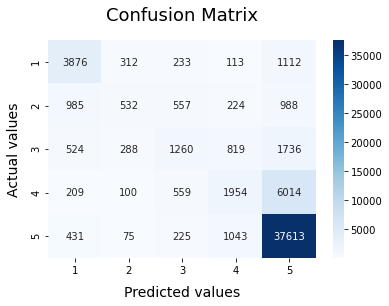

In [69]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF LogisticRegression
lr = LogisticRegression()
lr.fit(X_train, y_train)
model_Evaluate(lr)

From the classification report of the logistic regression classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 79% of the time, the classifier predicts score 5 correctly.

              precision    recall  f1-score   support

           1       0.74      0.14      0.23      5646
           2       0.00      0.00      0.00      3286
           3       0.22      0.00      0.00      4627
           4       0.29      0.01      0.03      8836
           5       0.65      0.99      0.79     39387

    accuracy                           0.65     61782
   macro avg       0.38      0.23      0.21     61782
weighted avg       0.54      0.65      0.53     61782



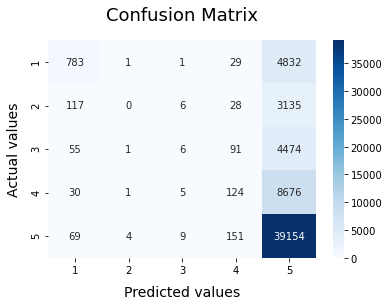

In [70]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF MultinomialNB
nb = MultinomialNB()
nb.fit(X_train, y_train)
model_Evaluate(nb)

From the classification report of the multinomial NB classifier, according to the precision scores we see that the predicted values of score 1 is closer to the actual values compared to the other scores. Meaning 74% of the time, the classifier predicts score 1 correctly.

              precision    recall  f1-score   support

           1       0.43      0.44      0.44      5646
           2       0.15      0.13      0.14      3286
           3       0.21      0.18      0.20      4627
           4       0.25      0.22      0.24      8836
           5       0.76      0.80      0.78     39387

    accuracy                           0.60     61782
   macro avg       0.36      0.35      0.36     61782
weighted avg       0.58      0.60      0.59     61782



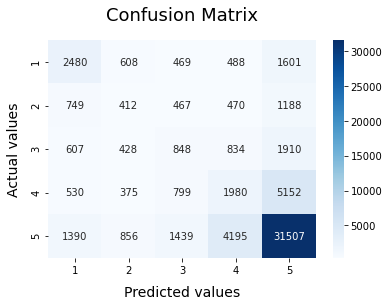

In [71]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
model_Evaluate(dt)


From the classification report of the Decision trees classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 5 correctly.

# BIGRAM Logistic Regression, MultinomialNB, DecisionTreeClassifier

The fifth and last text representation is the Bigram

A bigram or digram is a sequence of two adjacent elements from a string of tokens, which are typically 
letters, syllables, or words

In [59]:
from sklearn.feature_extraction.text import TfidfVectorizer

Here the attribute is the text reviews, which are the reviews in the dataset and the target is the score, which are the review scores of the text reviews. We then do a 80:20 train split.

In [60]:
#Splitting the dataset into training and test set
att = train['Review_text']
target = train['Score']
X_train, X_test, y_train, y_test = train_test_split(att,target,test_size=0.2,random_state=404,shuffle=True)

In [61]:
BI_vectoriser = TfidfVectorizer(ngram_range=(1,2), max_features=80000)
BI_vectoriser.fit(X_train)
BI_vectoriser.fit(X_test)
print('No. of feature_words: ', len(BI_vectoriser.get_feature_names()))

X_train = BI_vectoriser.transform(X_train)
X_test  = BI_vectoriser.transform(X_test)

No. of feature_words:  80000


In [62]:
feature_names = BI_vectoriser.get_feature_names()
# get_feature_name method returns a list where each entry corresponds to one feature:
print("Number of features: {}".format(len(feature_names))) # How many total features?
print("First 20 features:\n{}".format(feature_names[:20])) # Print feature name in range
print("Features 20010 to 20030:\n{}".format(feature_names[20010:20030]))
print("Every 2000th feature:\n{}".format(feature_names[::2000]))
#Q11 Explore with printing out different ranges/values of features and thing of what cleaning steps would make sense in this application


Number of features: 80000
First 20 features:
['01', '02', '05', '05 lb', '05 liter', '050', '05g', '07', '08', '09', '0g', '0g trans', '0gcholesterol', '0gcholesterol 0mgsodium', '0mg', '0mg cholesterol', '0mgsodium', '0z', '10', '10 10']
Features 20010 to 20030:
['dinner table', 'dinner tasty', 'dinner time', 'dinner treat', 'dinners', 'dino', 'dinosaur', 'dinosaurs', 'dioxide', 'dip', 'dip bread', 'dip chicken', 'dip good', 'dip great', 'dip mix', 'dipotassium', 'dipotassium phosphate', 'dipped', 'dipped chocolate', 'dipped milk']
Every 2000th feature:
['01', 'added sodium', 'amount carbs', 'bag smelled', 'bit peppery', 'breeder recommended', 'carry', 'chunk cookies', 'contact seller', 'cutting half', 'dinner kits', 'eat due', 'ever tasted', 'fek', 'flo teas', 'ful highly', 'going much', 'great natural', 'highquality food', 'inhibits', 'kosher use', 'like sesame', 'love hazelnut', 'matcha', 'morning eating', 'nonreturnable', 'onto amazon', 'past christmas', 'popcorns', 'products see'

# Hyperparameter tuning

The code below is used for finding out which is the best classifiers among the three classifiers. This does cross validation search of 10 times for each classifiers looking at different parameters.

In [75]:
# Set grid search params
param_range = [9, 10]
param_range_fl = [1.0, 0.5]
param_alpha = [1, 0.1] 


grid_params_lr = [{'penalty': ['l1', 'l2'],
                   'C': param_range_fl,
                   'solver': ['liblinear']}] 

grid_params_nb = [{'alpha': param_alpha,
                   'fit_prior': [True, False]}] 

grid_params_dt = [{'criterion': ['gini', 'entropy'],
                   'max_depth': param_range,
                   'min_samples_split': param_range[1:]}] 

'''grid_params_svm = [{'kernel': ['linear', 'rbf'], 
                    'C': param_range}]'''

# Construct grid searches
jobs = -1

LR = GridSearchCV(estimator=LogisticRegression(),
            param_grid=grid_params_lr,
            scoring='accuracy',
            cv=3) 


NB = GridSearchCV(estimator=MultinomialNB(),
            param_grid=grid_params_nb,
            scoring='accuracy',
            cv=3) 

DT = GridSearchCV(estimator=DecisionTreeClassifier(),
            param_grid=grid_params_dt,
            scoring='accuracy',
            cv=3)

'''SVM = GridSearchCV(estimator=SVC(),
            param_grid=grid_params_svm,
            scoring='accuracy',
            cv=3)'''


# List of pipelines for iterating through each of them
grids = [LR,NB,DT]

# Creating a dict for our reference
grid_dict = {0: 'Logistic Regression', 
             1: 'MultinomialNB',
             2: 'DecisionTreeClassifier'}

# Fit the grid search objects
print('Performing model optimizations...')
best_acc = 0.0
best_clf = 0
best_gs = ''
for idx, gs in enumerate(grids):
    print('\nEstimator: %s' % grid_dict[idx])
    gs.fit(X_train, y_train)
    print('Best params are : %s' % gs.best_params_)
    # Best training data accuracy
    print('Best training accuracy: %.3f' % gs.best_score_)
    # Predict on test data with best params
    y_pred = gs.predict(X_test)
    # Test data accuracy of model with best params
    print('Test set accuracy score for best params: %.3f ' % accuracy_score(y_test, y_pred))
    # Track best (highest test accuracy) model
    if accuracy_score(y_test, y_pred) > best_acc:
        best_acc = accuracy_score(y_test, y_pred)
        best_gs = gs
        best_clf = idx
print('\nClassifier with best test set accuracy: %s' % grid_dict[best_clf])



Performing model optimizations...

Estimator: Logistic Regression
Best params are : {'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}
Best training accuracy: 0.734
Test set accuracy score for best params: 0.739 

Estimator: MultinomialNB
Best params are : {'alpha': 0.1, 'fit_prior': True}
Best training accuracy: 0.708
Test set accuracy score for best params: 0.711 

Estimator: DecisionTreeClassifier
Best params are : {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 10}
Best training accuracy: 0.651
Test set accuracy score for best params: 0.647 

Classifier with best test set accuracy: Logistic Regression


From this we can conclude that Logistic Regression has the best accuracy among the three with an accuracy of 73.9%.

Displaying the confusion matrix and classification report. We pass on the model to the function we created to get the visualization of the confusion matrix.

              precision    recall  f1-score   support

           1       0.64      0.69      0.66      5646
           2       0.41      0.16      0.23      3286
           3       0.44      0.27      0.34      4627
           4       0.47      0.22      0.30      8836
           5       0.79      0.95      0.87     39387

    accuracy                           0.73     61782
   macro avg       0.55      0.46      0.48     61782
weighted avg       0.69      0.73      0.69     61782



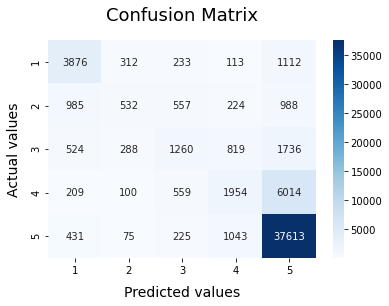

In [72]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF LogisticRegression
lr = LogisticRegression()
lr.fit(X_train, y_train)
model_Evaluate(lr)


From the classification report of the logistic regression classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 79% of the time, the classifier predicts score 5 correctly.

              precision    recall  f1-score   support

           1       0.74      0.14      0.23      5646
           2       0.00      0.00      0.00      3286
           3       0.22      0.00      0.00      4627
           4       0.29      0.01      0.03      8836
           5       0.65      0.99      0.79     39387

    accuracy                           0.65     61782
   macro avg       0.38      0.23      0.21     61782
weighted avg       0.54      0.65      0.53     61782



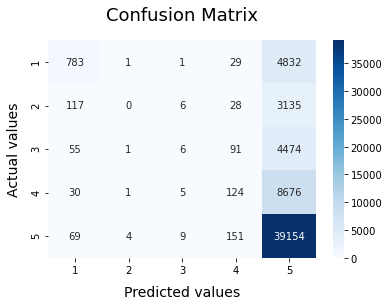

In [73]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF MultinomialNB
nb = MultinomialNB()
nb.fit(X_train, y_train)
model_Evaluate(nb)

From the classification report of the multinomial NB classifier, according to the precision scores we see that the predicted values of score 1 is closer to the actual values compared to the other scores. Meaning 74% of the time, the classifier predicts score 1 correctly.

              precision    recall  f1-score   support

           1       0.43      0.43      0.43      5646
           2       0.15      0.12      0.13      3286
           3       0.21      0.19      0.20      4627
           4       0.25      0.23      0.24      8836
           5       0.76      0.80      0.78     39387

    accuracy                           0.60     61782
   macro avg       0.36      0.35      0.36     61782
weighted avg       0.59      0.60      0.59     61782



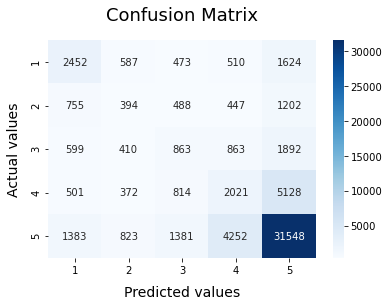

In [74]:
#CONFUSION MATRIX AND CLASSIFICATION REPORT OF DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
model_Evaluate(dt)


From the classification report of the Decision trees classifier, according to the precision scores we see that the predicted values of score 5 is closer to the actual values compared to the other scores. Meaning 76% of the time, the classifier predicts score 5 correctly.

CONCLUSION OF VECTORIZER AND CLASSIFIERS:

THE BEST REPRESENATION TECHNIQUE IS TF-IDF VECTORIZER WITH THE LOGISTIC RERESSION WHICH PRODUCED AN ACCURAY OF 73.4 IN TRAIN DATA & AN ACUURACY OF 73 ON TEST DATA.
    THE USE OF BIGRAM LEAD TO THE IMPROVEMENT OF ACCURACY IN CLASSSIFIERS LIKE LOGISTIC REGRESSION, MULTINOMIAL & DECISION TREE CLASSIFIER.

# Part 5-  Modelling text as a Sequence

Experiments with a least one model that looks at the text as a sequence (RNN, LSTM...)

 Retrieve the max length of our train data

In [17]:
#LSTm needs same length of tweets as inputs.
# get max length of the train data
max_length = max([len(s.split()) for s in train.Review_text])

importing required libraries

In [18]:
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.models import load_model
from keras.layers import Embedding, LSTM
from keras.layers.core import Dense, Dropout
from keras.callbacks import ReduceLROnPlateau
from numpy import asarray
from numpy import zeros

In [19]:
train2 = pd.read_csv('train.csv')

In [20]:
train3 = train2.head(10000)

In [21]:
train3.head(5)

,Score,Review_text
0,5,I received this product early from the seller!...
1,5,*****<br />Numi's Collection Assortment Melang...
2,5,"I was very careful not to overcook this pasta,..."
3,5,Buying this multi-pack I was misled by the pic...
4,5,These bars are so good! I loved them warmed up...


Cleaning the data and preprocessing using stop word removal and lemmatisation

In [22]:
def preprocess_Reviews_text(Reviews):
    Reviews = Reviews.lower() #lowercase
    Reviews = re.sub("<br />",'',Reviews) #Removing </br>
#     Reviews = re.sub("<a href>",'',Reviews) #Removing <ahref>
#     Reviews = re.sub("</a>",'',Reviews) #Removing </a>
    Reviews = re.sub("<a href='https?:\/\/\S+> </a>",'', Reviews)
#   Reviews = re.sub(r'https?:\/\/\S+','', Reviews) #Remove the hyperlink
    Reviews = re.sub(r'#','',Reviews) # Removing # symbol 
    Reviews = re.sub('[%s]' % re.escape(string.punctuation), '' , Reviews) #remove punctuation like '!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~'
    Reviews = re.sub('(http[s]?S+)|(w+.[A-Za-z]{2,4}S*)', '', Reviews) # remove url
    Reviews = re.sub("[^a-z0-9]"," ", Reviews) #Remove alphanumeric
#     tweet_tokens = word_tokenize(Reviews) # tokenise & stop word removal
    filtered_words = [word for word in Reviews if word not in stop_words]
    lemetizer = WordNetLemmatizer() # lemmatize
    lemma_words = [lemetizer.lemmatize(w,pos='a') for w in filtered_words]
#  Reviews = re.sub(r'rt[\s]+', '',Reviews)
#  Reviews = re.sub(r'@[A-Za-z0-9]+', '',Reviews) #Remove @mentions
    return " ".join(lemma_words)

In [23]:
train3['Review_text'] = train3['Review_text'].apply(preprocess_Reviews_text)
train3.head(10)

,Score,Review_text
0,5,r e c e v e h p r u c e r l f r h ...
1,5,n u c l l e c n r e n e l n g e n c l ...
2,5,w v e r c r e f u l n v e r c k ...
3,5,b u n g h u l p c k w l e b h e ...
4,5,h e e b r r e g l v e h e u ...
5,5,l v e h e e c h p b u h e 2 4 ...
6,5,h u g e f n f e n g c e r e l f ...
7,2,w r e l l p p n e h e r g h u w ...
8,3,f r e n w h h g n e k r e g v e ...
9,4,n n e e f r p l c b g g e r l p p ...


Displaying the train dataset and the test dataset distributions

In [24]:
# set 80% for our data to train
train_size = 0.8

# split our data into train set (80%) and test set (20%)
train_data, test_data = train_test_split(train3, test_size = 1 - train_size, random_state = 0, stratify = train3.Score)

# length of each set
print("Train data size: ", len(train_data))
print("Test data size: ", len(test_data))

# how many examples of each class there is in each set
print("Train data distr: ")
print(train_data.Score.value_counts())
print("Test data distr: ")
print(test_data.Score.value_counts())

Train data size:  8000
Test data size:  2000
Train data distr: 
5    5162
4    1127
1     738
3     555
2     418
Name: Score, dtype: int64
Test data distr: 
5    1291
4     281
1     185
3     138
2     105
Name: Score, dtype: int64


In [25]:
from sklearn.preprocessing import LabelEncoder
# create a label encoder
encoder = LabelEncoder()
# enconde labels (0 or 1) in train data
encoder.fit(train_data.Score.to_list())

# from sklearn.feature_extraction.text import CountVectorizer
# CV = CountVectorizer(lowercase=False)

# CV.fit(train_data.Score.to_list())

# transform labels in y_train and y_test data to the encoded ones
y_train = encoder.transform(train_data.Score.to_list())
y_test = encoder.transform(test_data.Score.to_list())

# reshape y_train and y_test data
y_train = y_train.reshape(-1, 1)
y_test = y_test.reshape(-1, 1)

Tokenizing and using pad sequence on the dataset.

In [26]:
from keras.preprocessing.text import Tokenizer
import pickle
# create a tokenizer
tokenizer = Tokenizer()
# fit the tokenizer in the train text
tokenizer.fit_on_texts(train_data.Review_text)

# saving tokenizer
with open('tokenizer.pickle', 'wb') as handle:
    pickle.dump(tokenizer, handle, protocol = pickle.HIGHEST_PROTOCOL)

In [27]:
# get max length of the train data
max_length = max([len(s.split()) for s in train_data.Review_text])

# pad sequences in x_train data set to the max length
x_train = pad_sequences(tokenizer.texts_to_sequences(train_data.Review_text),
                        maxlen = max_length)
# pad sequences in x_test data set to the max length
x_test = pad_sequences(tokenizer.texts_to_sequences(test_data.Review_text),
                       maxlen = max_length)

print("x_train shape: ", x_train.shape)
print("x_test shape: ", x_test.shape)

print("y_train shape:", y_train.shape)

x_train shape:  (8000, 2942)
x_test shape:  (2000, 2942)
y_train shape: (8000, 1)


Installing the gensim library. gensim is a technique to extract the underlying topics from large volumes of text.

In [61]:
! pip install gensim

Loading the word embedding layer as a disctionary consisting of all the words after being cleaned

In [28]:
# load embedding as a dict

def load_embedding(filename):
    # load embedding into memory, skip first line
    file = open(filename,'r',encoding="utf-8")
    lines = file.readlines()
    file.close()
    # create a map of words to vectors
    embedding = dict()
    for line in lines:
        parts = line.split()
        # key is string word, value is numpy array for vector
        embedding[parts[0]] = asarray(parts[1:], dtype='float32')
    return embedding

# create a weight matrix for the Embedding layer from a loaded embedding
def get_weight_matrix(embedding, vocab):
    # total vocabulary size plus 0 for unknown words
    vocab_size = len(vocab) + 1
    # define weight matrix dimensions with all 0
    weight_matrix = zeros((vocab_size, embedding_dim))
    # step vocab, store vectors using the Tokenizer's integer mapping
    for word, i in vocab.items():
        vector = embedding.get(word)
        if vector is not None:
            weight_matrix[i] = vector
    return weight_matrix

# contains the index for each word
vocab = tokenizer.word_index
# total number of words in our vocabulary, plus one for unknown words
vocab_size = len(tokenizer.word_index) + 1
# embedding dimensions
embedding_dim = 200

# load embedding from file
raw_embedding = load_embedding('glove.twitter.27B.200d.txt')
# get vectors in the right order
embedding_matrix = get_weight_matrix(raw_embedding, vocab)

print("Vocab size: ", vocab_size)
print("Max text length: ", max_length)
print("Embedding dim: ", embedding_dim)


Vocab size:  29
Max text length:  2942
Embedding dim:  200


# Model building and training

Creating the embedding layer. Word embeddings are basically a form of word representation that bridges the human understanding of language to that of a machine

In [29]:
# create the embedding layer
embedding_layer = Embedding(vocab_size, 
                            embedding_dim, 
                            weights = [embedding_matrix], 
                            input_length = max_length, 
                            trainable = False)

In [30]:
# define model
model = Sequential()
model.add(embedding_layer)
model.add(Dropout(0.2))
model.add(LSTM(200, dropout = 0.2))
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation = "softmax"))

print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 2942, 200)         5800      
                                                                 
 dropout (Dropout)           (None, 2942, 200)         0         
                                                                 
 lstm (LSTM)                 (None, 200)               320800    
                                                                 
 dense (Dense)               (None, 64)                12864     
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                                 
Total params: 339,529
Trainable params: 333,729
Non-trainable params: 5,800
_________________________________________________________________
None


In [31]:
BATCH_SIZE = 100
EPOCHS = 5

model.compile(optimizer = "adam", loss = 'categorical_crossentropy', metrics = ['accuracy'])

# callbacks
reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', 
                              factor = 0.1,
                              min_lr = 0.01)

# train model
history = model.fit(x_train, y_train, batch_size = BATCH_SIZE, epochs = EPOCHS,
                    validation_split = 0.1, verbose = 1, callbacks = [reduce_lr])


Epoch 1/5
72/72 [==============================] - 2340s 33s/step - loss: 0.0000e+00 - accuracy: 0.0518 - val_loss: 0.0000e+00 - val_accuracy: 0.0562 - lr: 0.0010
Epoch 2/5
72/72 [==============================] - 2946s 41s/step - loss: 0.0000e+00 - accuracy: 0.0518 - val_loss: 0.0000e+00 - val_accuracy: 0.0562 - lr: 0.0010
Epoch 3/5
72/72 [==============================] - 3175s 44s/step - loss: 0.0000e+00 - accuracy: 0.0518 - val_loss: 0.0000e+00 - val_accuracy: 0.0562 - lr: 0.0010
Epoch 4/5
72/72 [==============================] - 4366s 61s/step - loss: 0.0000e+00 - accuracy: 0.0518 - val_loss: 0.0000e+00 - val_accuracy: 0.0562 - lr: 0.0010
Epoch 5/5
72/72 [==============================] - 3907s 54s/step - loss: 0.0000e+00 - accuracy: 0.0518 - val_loss: 0.0000e+00 - val_accuracy: 0.0562 - lr: 0.0010


Training the model that will be used for review score prediction

In [ ]:
BATCH_SIZE = 1000
EPOCHS = 15

model.compile(optimizer = "adam", loss = 'categorical_crossentropy', metrics = ['accuracy'])

# callbacks
reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', 
                              factor = 0.1,
                              min_lr = 0.01)

# train model
history = model.fit(x_train, y_train, batch_size = BATCH_SIZE, epochs = EPOCHS,
                    validation_split = 0.1, verbose = 1, callbacks = [reduce_lr])

Epoch 1/15


In [32]:
# evaluate model
score = model.evaluate(x_test, y_test, batch_size = BATCH_SIZE)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

# save model
model.save('model_final.h5')

20/20 [==============================] - 344s 17s/step - loss: 0.0000e+00 - accuracy: 0.0525
Test loss: 0.0
Test accuracy: 0.05249999836087227


# Model Prediction

Using the model on a query to check if the model is accurate

In [61]:
# decode score prediction from the model, to be 0 or 1
def decode_prediction(prediction):
    return 1 if prediction < 0.5 else 5

# load model
model = load_model('model_final.h5')
# loading tokenizer
with open('tokenizer.pickle', 'rb') as handle:
    tokenizer = pickle.load(handle)

# test model with a new query
tweet = "im happy!!!"

# clean query text
input_text = preprocess_Reviews_text(tweet)
# tokenize and pad query test as in training
input_text = pad_sequences(tokenizer.texts_to_sequences([input_text]),
                        maxlen = max_length)

# get model prediction
prediction = model.predict([input_text])[0]
# get decode prediction
label = decode_prediction(prediction)

print("Tweet: \n\n{}\n".format(tweet))
print("Score: {} Label: {}".format(prediction, label))

Tweet: 

im happy!!!

Score: [1.] Label: 5


# PART 6- TOPIC MODELLING

Examine the five-star reviews and the one-star reviews separately

importing required libraries

In [46]:
from sklearn.datasets import load_files
import numpy as np
import requests, zipfile, io

We will be using the trained dataset for the topic modelling

In [47]:
train = pd.read_csv('train.csv').head(1000)

In [48]:
train.head()

,Score,Review_text
0,5,I received this product early from the seller!...
1,5,*****<br />Numi's Collection Assortment Melang...
2,5,"I was very careful not to overcook this pasta,..."
3,5,Buying this multi-pack I was misled by the pic...
4,5,These bars are so good! I loved them warmed up...


In [49]:
text_train, y_train = train.Score, train.Review_text
print("type of text_train: {}".format(type(text_train)))
print("length of text_train: {}".format(len(text_train)))

type of text_train: <class 'pandas.core.series.Series'>
length of text_train: 1000


In [52]:
# text_train = [doc.replace(b"<br />", b" ") for doc in text_train]

In [28]:
np.unique(y_train)

array(['"Newman\'s Own" products are generally very good, with high quality ingediants and perfect execution.  This Organic Dark Chocolate bar (54% cocoa) was perfectly sweet, without being bitter or too rich.  Two of us spent an hour slowly munching through one bar, savoring every bite.<br /><br />A real treat of high quality dark chocolate.  Definitely worth a try! Very Good, and Certified Organic',
       '*****<br />I enjoy Numi\'s Moonlight Spice Orange Spice White Tea. It has a distinctive orangey taste and a light spicy taste (from the cinnamon, cloves, allspice, and ginger), sort of like a light, subtle, orangey chai tea. It is different and unique and all of the flavors are much more subtle than a chai-type tea, quite adventurous. It brews for a lengthier time (7-8 minutes) and is worth the wait.<br /><br />Moonlight Spice is kosher, certified organic and contains amazing ingredients: organic cinnamon, organic orange peel, organic cloves, fair trade certified organic Pai Mu Ta

In [29]:
from sklearn.feature_extraction.text import CountVectorizer

In [30]:
vect = CountVectorizer(max_features=10000, max_df=.15)
X = vect.fit_transform(y_train)

In [31]:
from sklearn.decomposition import LatentDirichletAllocation

 We are importing a model called Latent Dirichlet Allocation to do the topic modelling. The latent Dirichlet allocation (LDA) is a generative 
statistical model that allows sets of observations to be explained by unobserved groups that explain why some parts of the data are similar

In [32]:
lda = LatentDirichletAllocation(n_components=10, learning_method="batch",
                                max_iter=25, random_state=0)
# learn 10 topics
# We build the model and transform the data in one step
# Computing transform takes some time,
# and we can save time by doing both at once
document_topics = lda.fit_transform(X)

In [33]:
print("lda.components_.shape: {}".format(lda.components_.shape))
#  LDA components store (n topics, n words)

lda.components_.shape: (10, 7117)


In [34]:
# for each topic (a row in the components_), sort the features (ascending).
# Invert rows with [:, ::-1] to make sorting descending
sorting = np.argsort(lda.components_, axis=1)[:, ::-1]
# get the feature names from the vectorizer:
feature_names = np.array(vect.get_feature_names())
#prints the most important words for each topic

In [36]:
# !pip install mglearn

     -------------------------------------- 540.1/540.1 KB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 3.3/3.3 MB 15.2 MB/s eta 0:00:00
  Created wheel for mglearn: filename=mglearn-0.1.9-py2.py3-none-any.whl size=582637 sha256=be8bfcf7ab38dfda300a7d8dc9288353e873e1029070d61f36a4f8ff91a0d876
  Stored in directory: c:\users\hp\appdata\local\pip\cache\wheels\df\30\8a\1e2c8f144c9d411b0688f628d496d2db8f61b6d14bcedaa1df
Successfully built mglearn


In [37]:
%matplotlib inline
import mglearn as mglearn
import matplotlib as plt

Printing out the first 10 topics from the dataset. Each topic has a review where the first word in each topic is the moct occuring word in the review

In [38]:
# Print out the 10 topics:
mglearn.tools.print_topics(topics=range(10), feature_names=feature_names,
                           sorting=sorting, topics_per_chunk=5, n_words=10)

topic 0       topic 1       topic 2       topic 3       topic 4       
--------      --------      --------      --------      --------      
coffee        tea           coffee        free          coffee        
up            best          what          tea           chocolate     
by            find          there         chips         salt          
there         sodium        bars          better        hot           
some          ever          ve            favorite      sauce         
little        orange        best          too           too           
use           salt          only          make          milk          
don           tastes        then          think         an            
your          were          tea           gluten        which         
sugar         drink         also          delicious     your          


topic 5       topic 6       topic 7       topic 8       topic 9       
--------      --------      --------      --------      --------      
coff

Printing out the first 100 topics from the dataset.

In [39]:
lda100 = LatentDirichletAllocation(n_components=100, learning_method="batch",
                                   max_iter=25, random_state=0)
document_topics100 = lda100.fit_transform(X)

Displaying random numbered topics from the first 100

In [40]:
topics = np.array([7, 16, 24, 25, 28, 36, 37, 41, 45, 51, 53, 54, 63, 89, 97])

In [41]:
sorting = np.argsort(lda100.components_, axis=1)[:, ::-1]
feature_names = np.array(vect.get_feature_names())
mglearn.tools.print_topics(topics=topics, feature_names=feature_names,
                           sorting=sorting, topics_per_chunk=5, n_words=20)
#we select some of the 100 topics to look at 


topic 7       topic 16      topic 24      topic 25      topic 28      
--------      --------      --------      --------      --------      
food          add           tea           kit           cup           
he            subscription  make          teas          far           
every         coffee        ve            wonderful     made          
too           price         delicious     artificial    ve            
old           stew          found         fermentation  coffee        
cat           enough        first         variety       better        
your          cats          up            jars          tea           
time          been          daughter      thank         makes         
up            up            cake          amazing       half          
there         because       she           scoobys       mix           
month         first         old           scooby        found         
tunnel        do            brand         going         low           
eat   

In [64]:
# Looking at documents that are assigned to topic 45(hot)  
# sort by weight of "hot" topic 45
# hot = np.argsort(document_topics100[:, 45])[::-1]
# print the five documents where the topic is most important
# for i in hot[:10]:
#     # show first two sentences
#     print(b".".join(text_train[i].split(b".")[:2]) + b".\n")

 Created a visualization graph of the topics which we see belowwhich shows the top 2 words the occur the most in each topic

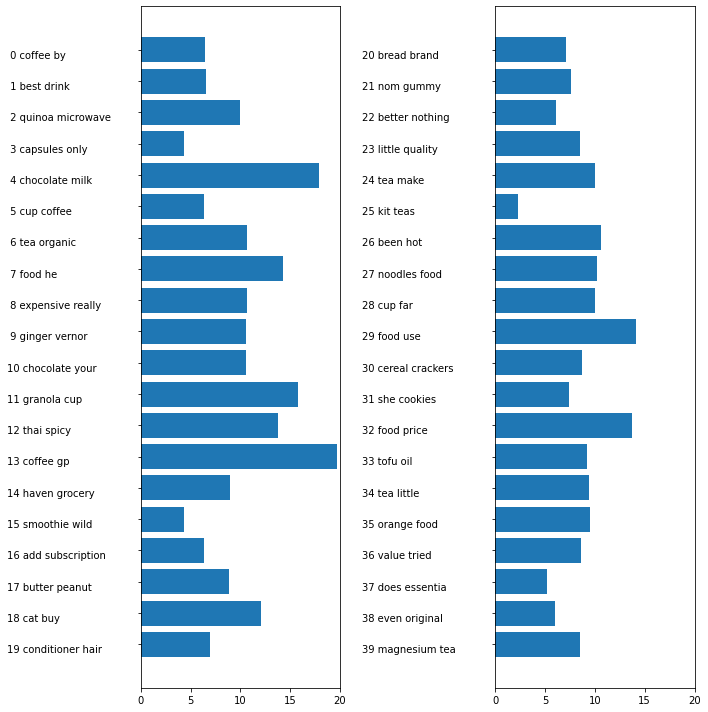

In [57]:

import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 2, figsize=(10, 10))
topic_names = ["{:>2} ".format(i) + " ".join(words)
               for i, words in enumerate(feature_names[sorting[:, :2]])]
# two column bar chart:
for col in [0, 1]:
    start = col * 20
    end = (col + 1) * 20
    ax[col].barh(np.arange(20), np.sum(document_topics100, axis=0)[start:end])
    ax[col].set_yticks(np.arange(20))
    ax[col].set_yticklabels(topic_names[start:end], ha="left", va="top")
    ax[col].invert_yaxis()
    ax[col].set_xlim(0, 20)
    yax = ax[col].get_yaxis()
    yax.set_tick_params(pad=130)
plt.tight_layout()
#Q6 Identify genre-specific topics and rating-specific topics below? Can you find amore categories 

# Topic Model Visualization using pyLDAvis

Installing pyLDAvis library

In [60]:
# pip install pyLDAvis

     ---------------------------------------- 1.7/1.7 MB 5.9 MB/s eta 0:00:00
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
     ---------------------------------------- 24.0/24.0 MB 4.0 MB/s eta 0:00:00
     -------------------------------------- 829.2/829.2 KB 8.8 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     -------------------------------------- 88.5/88.5 KB 554.8 kB/s eta 0:00:00
     -------------------------------------- 58.6/58.6 KB 103.4 kB/s eta 0:00:00
     ---------------------------------------- 1.7/1.7 MB 5.3 MB/

In [61]:
from __future__ import print_function
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

Displaying the visualization for 10 topics

In [62]:
pyLDAvis.sklearn.prepare(lda, X,vect) # visualization for 10 topics


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.141284  0.021497       1        1  19.400416
2     -0.017366 -0.017093       2        1  17.806851
0     -0.030247 -0.000927       3        1  10.956334
6      0.011774 -0.051967       4        1  10.866740
8     -0.071672 -0.044504       5        1  10.676454
4      0.001609  0.029088       6        1   9.561507
9      0.038001  0.155450       7        1   6.797545
5      0.127461 -0.030719       8        1   4.933917
1      0.028022 -0.053049       9        1   4.808090
3      0.053701 -0.007775      10        1   4.192147, topic_info=        Term        Freq       Total Category  logprob  loglift
1351  coffee  247.000000  247.000000  Default  30.0000  30.0000
1969     dog  142.000000  142.000000  Default  29.0000  29.0000
6279     tea  242.000000  242.000000  Default  28.0000  28.0000
2983      he  146.000000  146.000000  Default  27.0000  27.0000
6533  treats   80.000000   80.000000  Default  26.0000  26.0000
...      ...         ...         ...      ...      ...      ...
4072    most    4.917875   65.862949  Topic10  -5.9865   0.5773
2466    find    5.213877  123.980900  Topic10  -5.9280   0.0032
6716     use    5.264253  159.271003  Topic10  -5.9184  -0.2377
1962      do    5.150736  126.541922  Topic10  -5.9402  -0.0295
4264     now    5.078841  107.689111  Topic10  -5.9542   0.1178

[771 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
0         1  0.128453        00
0         3  0.642267        00
0        10  0.128453        00
35        7  0.803373      1866
42        4  0.862843       19g
...     ...       ...       ...
7103      4  0.143708      zico
7103      5  0.718540      zico
7109      5  0.866497   zipfizz
7110      2  0.837073  ziwipeak
7115      1  0.941850      zuke

[2092 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 3, 1, 7, 9, 5, 10, 6, 2, 4])

In the visualization graph above we have imported 10 topics into the pyLDAvis model and we see that ‘coffee’ has the highest frequency out of all the words

Displaying the visualization for 100 topics

In [63]:
pyLDAvis.sklearn.prepare(lda100, X,vect) #visualization for 100 topics

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
48     0.148690 -0.212327       1        1  3.790283
29     0.096028 -0.102557       2        1  2.540174
47     0.115494 -0.047400       3        1  2.495144
11     0.123809  0.029155       4        1  2.324879
13     0.095234  0.062923       5        1  2.233172
...         ...       ...     ...      ...       ...
1     -0.120352 -0.045420      96        1  0.300715
15    -0.143879  0.001875      97        1  0.277892
74    -0.170367  0.028987      98        1  0.252825
25    -0.192825 -0.026388      99        1  0.187835
51    -0.212160  0.000104     100        1  0.172139

[100 rows x 5 columns], topic_info=            Term        Freq       Total  Category  logprob  loglift
1351      coffee  259.000000  259.000000   Default   30.000  30.0000
1969         dog  144.000000  144.000000   Default   29.000  29.0000
6279         tea  246.000000  246.000000   Default   28.000  28.0000
2983          he  143.000000  143.000000   Default   27.000  27.0000
2555        food  223.000000  223.000000   Default   26.000  26.0000
...          ...         ...         ...       ...      ...      ...
997           by    0.559175  112.544006  Topic100   -4.968   1.0600
1351      coffee    0.559175  259.505273  Topic100   -4.968   0.2246
1377         com    0.559175   36.482447  Topic100   -4.968   2.1865
1919  discovered    0.559175   11.819003  Topic100   -4.968   3.3136
2076      during    0.559175   19.260982  Topic100   -4.968   2.8252

[6609 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
2        34  0.585136  0472066978
4        31  0.401985          07
4        84  0.401985          07
5        34  0.585136  0738551856
6        82  0.607003          0g
...     ...       ...         ...
7112     84  0.397099         zoe
7113     96  0.660901        zola
7115      2  0.480696        zuke
7115     43  0.320464        zuke
7115     47  0.160232        zuke

[22053 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[49, 30, 48, 12, 14, 3, 61, 64, 88, 40, 8, 90, 58, 5, 42, 33, 76, 47, 96, 63, 72, 95, 56, 7, 62, 73, 85, 92, 77, 86, 91, 27, 53, 10, 1, 83, 11, 99, 80, 19, 94, 82, 18, 67, 44, 43, 29, 97, 28, 41, 32, 37, 74, 24, 60, 78, 93, 84, 13, 25, 65, 36, 45, 6, 20, 34, 9, 51, 39, 31, 68, 46, 57, 17, 35, 98, 71, 55, 79, 81, 69, 70, 21, 22, 59, 89, 50, 15, 4, 54, 38, 23, 66, 100, 87, 2, 16, 75, 26, 52])

In the visualization graph above we have imported 100 topics into the pyLDAvis model and we see that ‘coffee’ has the highest frequency out of all the words

# KAGGLE COMPETITION 

Using TF-IDF vectorizer and Logistic Regression for labeling the test data (text.csv)

1. TRAINING THE DATA

In [210]:
train_new= pd.read_csv('train.csv')

In [211]:
import nltk
nltk.download('omw-1.4')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [212]:
contractions_dict = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have",
    
    
}

In [213]:
# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))
def expand_contractions(Review_text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, Review_text)
# Expanding Contractions in the reviews
train_new['Review_text']=train_new['Review_text'].apply(lambda x:expand_contractions(x))

In [214]:
# cleaninng tweets
Reviews = train_new['Review_text']

def preprocess_Reviews_text(Reviews):
    Reviews = Reviews.lower() #lowercase
    Reviews = re.sub("<br />",'',Reviews) #Removing </br>
#     Reviews = re.sub("<a href>",'',Reviews) #Removing <ahref>
#     Reviews = re.sub("</a>",'',Reviews) #Removing </a>
    Reviews = re.sub("<a href='https?:\/\/\S+> </a>",'', Reviews)
#   Reviews = re.sub(r'https?:\/\/\S+','', Reviews) #Remove the hyperlink
    Reviews = re.sub(r'#','',Reviews) # Removing # symbol 
    Reviews = re.sub('[%s]' % re.escape(string.punctuation), '' , Reviews) #remove punctuation like '!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~'
    Reviews = re.sub('(http[s]?S+)|(w+.[A-Za-z]{2,4}S*)', '', Reviews) # remove url
    Reviews = re.sub("[^a-z0-9]"," ", Reviews) #Remove alphanumeric
    tweet_tokens = word_tokenize(Reviews) # tokenise & stop word removal
    filtered_words = [word for word in tweet_tokens if word not in stop_words]
    lemetizer = WordNetLemmatizer() # lemmatize
    lemma_words = [lemetizer.lemmatize(w,pos='a') for w in filtered_words]
#  Reviews = re.sub(r'rt[\s]+', '',Reviews)
#  Reviews = re.sub(r'@[A-Za-z0-9]+', '',Reviews) #Remove @mentions
    return " ".join(lemma_words)

train_new['Review_text'] = train_new['Review_text'].apply(preprocess_Reviews_text)
train_new.head(10)

,Score,Review_text
0,5,received product early seller tastey great mid...
1,5,numis collection assortment melange includes5 ...
2,5,careful overcook pasta making sure take bite e...
3,5,buying multipack misled picture hazel nuts ano...
4,5,bars good loved definitely think great snack b...
5,5,love chips buy 24 pack month bags right size s...
6,5,huge fan eating cereal breakfast light tastes ...
7,2,really disappointed sorghum purchased users 50...
8,3,friend gone korea gave couple packs try found ...
9,4,need plastic baggies sloppy tin foil rs honey ...


In [215]:
train_new.loc[107,'Review_text']

'ful fresh natural juice added sugar use agave enough love pure passion fruit juice juices advertised passion fruit mostly pear apple juice splash passion fruit great product great price'

In [216]:
# USING TF-IDF TO FIT_TRANSFORM THE TRAIN DATA
tfidf = TfidfVectorizer()
X_train = tfidf.fit_transform(train_new['Review_text'])

In [171]:
X_train.shape

(426340, 281060)

In [217]:
#TRAINING THE LOGISTIC REGRESSION ON TRAIN DATA
lr = LogisticRegression()
lr.fit(X_train, train_new.Score)



LogisticRegression()

2. TEST DATA

In [219]:
test = pd.read_csv('test.csv')

In [220]:
test

,Id,Review_text
0,1,I have a very picky German Shephard mix and sh...
1,2,It is hard to believe that this candy is sugar...
2,3,These are delicious cookies but I just cancell...
3,4,I should have ordered more of these bones as m...
4,5,One big complaint I have about protein bars is...
...,...,...
142109,142110,I think some of this works but bottom line is ...
142110,142111,I recently reviewed Crystal Light's Margarita ...
142111,142112,Perfect size can and a refreshing drink. I thi...
142112,142113,"I bought this at the grocery store, and it sme..."


Preprocessing the test data

In [221]:
import nltk
nltk.download('omw-1.4')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ANAIDA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [222]:
contractions_dict = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have",
    
    
}

In [223]:
# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))
def expand_contractions(Review_text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, Review_text)
# Expanding Contractions in the reviews
test['Review_text']=test['Review_text'].apply(lambda x:expand_contractions(x))

In [224]:
# cleaninng tweets
Reviews = test['Review_text']

def preprocess_Reviews_text(Reviews):
    Reviews = Reviews.lower() #lowercase
    Reviews = re.sub("<br />",'',Reviews) #Removing </br>
#     Reviews = re.sub("<a href>",'',Reviews) #Removing <ahref>
#     Reviews = re.sub("</a>",'',Reviews) #Removing </a>
    Reviews = re.sub("<a href='https?:\/\/\S+> </a>",'', Reviews)
#   Reviews = re.sub(r'https?:\/\/\S+','', Reviews) #Remove the hyperlink
    Reviews = re.sub(r'#','',Reviews) # Removing # symbol 
    Reviews = re.sub('[%s]' % re.escape(string.punctuation), '' , Reviews) #remove punctuation like '!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~'
    Reviews = re.sub('(http[s]?S+)|(w+.[A-Za-z]{2,4}S*)', '', Reviews) # remove url
    Reviews = re.sub("[^a-z0-9]"," ", Reviews) #Remove alphanumeric
    tweet_tokens = word_tokenize(Reviews) # tokenise & stop word removal
    filtered_words = [word for word in tweet_tokens if word not in stop_words]
    lemetizer = WordNetLemmatizer() # lemmatize
    lemma_words = [lemetizer.lemmatize(w,pos='a') for w in filtered_words]
#  Reviews = re.sub(r'rt[\s]+', '',Reviews)
#  Reviews = re.sub(r'@[A-Za-z0-9]+', '',Reviews) #Remove @mentions
    return " ".join(lemma_words)

test['Review_text'] = test['Review_text'].apply(preprocess_Reviews_text)
test.head(10)

,Id,Review_text
0,1,picky german shephard mix eat dog biscuits dog...
1,2,hard believe candy sugar free tastes like regu...
2,3,delicious cookies cancelled subscription hope ...
3,4,ordered bones dogs shared favorite dingo bone ...
4,5,one big complaint protein bars manufacturers g...
5,6,mornings time make good breakfast thats orgain...
6,7,attracted packaging purchased bag classic sea ...
7,8,absolutely love caribou blends dark roast tast...
8,9,pondering r purchase product first mostly rese...
9,10,tea high quality came biodegradable pouches lo...


In [225]:
test.loc[107,'Review_text']

'revie pretty much title coffee fantastic great flavor highly recommend coffee lovers therethe trouble shipping one vacuum sealed bricks compromised slice side itnevertheless coffee still useable opinion coffee fantastic'

3. Applying TF-IDF transform on test data

In [226]:
#t_vectoriser = TfidfVectorizer()
X_test = tfidf.transform(test['Review_text'])


In [21]:
# Predicting the labels(Scores)
y = lr.predict(X_test)


NameError: name 'lr' is not defined

In [229]:
y

array([5, 5, 5, ..., 5, 1, 1], dtype=int64)

In [244]:
sample=pd.read_csv('sample_submission.csv') # Compare to majority class
sample.head()
sample.describe()


,Id,Score
count,10.00000,10.000000
mean,5.50000,3.300000
std,3.02765,1.337494
min,1.00000,1.000000
25%,3.25000,2.250000
50%,5.50000,3.500000
75%,7.75000,4.000000
max,10.00000,5.000000


In [240]:
sample['Id']= test['Id']
sample['Score'] = y # save the labels for your model to csv file 
sample.to_csv('mySubmission.csv', index=False)

# REFERENCE LINKS

https://medium.com/@karyrs1506/sentiment-analysis-on-tweets-with-lstm-22e3bbf93a61
https://github.com/susanli2016/PyCon-Canada-2019-NLP-Tutorial/blob/master/BBC%20News_LSTM.ipynb
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
https://machinelearningmastery.com/cross-entropy-for-machine-learning/
https://snap.stanford.edu/data/web-FineFoods.html
https://nlp.stanford.edu/projects/glove/
https://towardsdatascience.com/creating-word-embeddings-coding-the-word2vec-algorithm-in-python-using-deep-learning-b337d0ba17a8
https://medium.com/@canerkilinc/padding-for-nlp-7dd8598c916a
https://towardsdatascience.com/a-complete-exploratory-data-analysis-and-visualization-for-text-data-29fb1b96fb6a